In [1]:
import numpy as np
import ellc
import matplotlib.pyplot as plt
import lightkurve as lk

In [2]:
%run setup.py

In [3]:
t, y, yerr = np.loadtxt('data/photometry/adra_sap_spline_corrected.txt', usecols=(0,1,2)).T
# tjd_0 = 2457000
# t += tjd_0
t0_guess = t[np.argmin(y)]

In [4]:
%config IPython.matplotlib.backend = "retina"
from matplotlib import rcParams
# rcParams["figure.dpi"] = 300
# rcParams["savefig.dpi"] = 150

Text(0, 0.5, 'Flux')

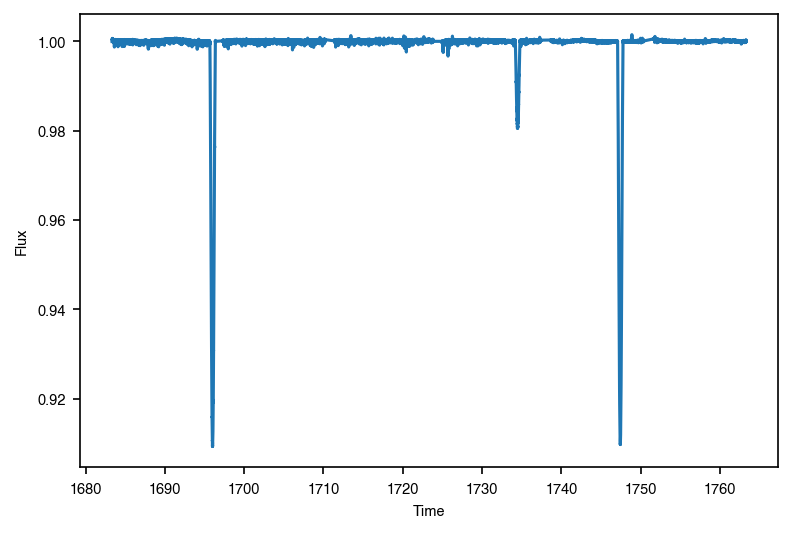

In [5]:
plt.plot(t,y)
plt.xlabel('Time')
plt.ylabel('Flux')

Text(0, 0.5, 'Flux')

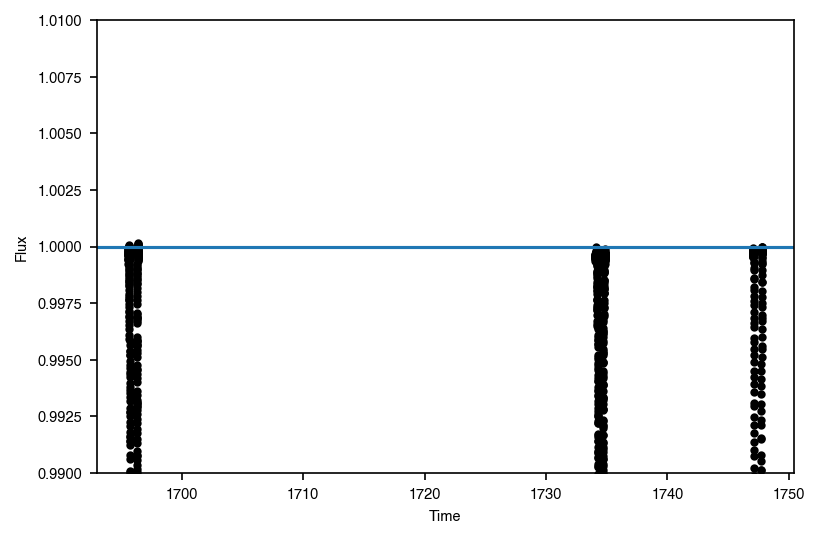

In [6]:
t0_guess = t[np.argmin(y)]

spacing = 0.4

y_transit = y[(t > t0_guess-spacing) & (t < t0_guess+spacing)]
t_transit = t[(t > t0_guess-spacing) & (t < t0_guess+spacing)]
yerr_transit = yerr[(t > t0_guess-spacing) & (t < t0_guess+spacing)]

plt.plot(t_transit, y_transit, '.k')
plt.xlabel('Time')
plt.ylabel('Flux')

t1_guess = t[t>1700][np.argmin(y[t>1700])]
y_transit2 = y[(t > t1_guess-spacing) & (t < t1_guess+spacing)]
t_transit2 = t[(t > t1_guess-spacing) & (t < t1_guess+spacing)]
yerr_transit2 = yerr[(t > t1_guess-spacing) & (t < t1_guess+spacing)]

t2_guess = t[(t>1700) & (t<1740)][np.argmin(y[(t>1700) & (t<1740)])]
y_transit3 = y[(t > t2_guess-spacing) & (t < t2_guess+spacing)]
t_transit3 = t[(t > t2_guess-spacing) & (t < t2_guess+spacing)]
yerr_transit3 = yerr[(t > t2_guess-spacing) & (t < t2_guess+spacing)]

y_transit /= np.max(y_transit)
y_transit2 /= np.max(y_transit2)
y_transit3 /= np.max(y_transit3)

plt.plot(t_transit, y_transit, '.k')
plt.plot(t_transit2, y_transit2, '.k')
plt.plot(t_transit3, y_transit3, '.k')

plt.ylim(0.99,1.01)
plt.axhline(1.)
plt.xlabel('Time')
plt.ylabel('Flux')

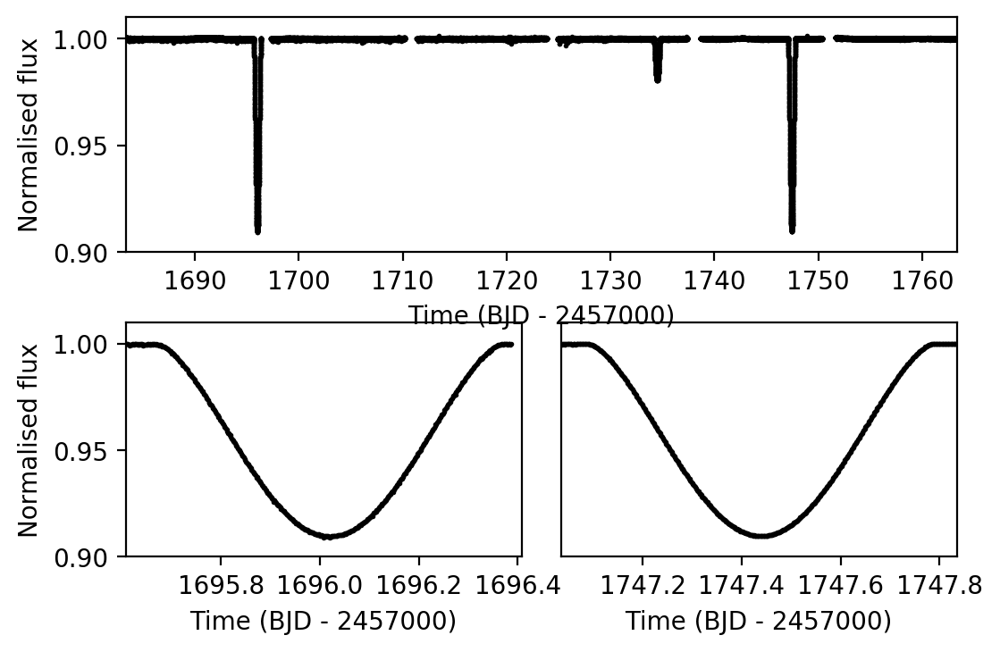

In [6]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots(
#     figsize=mnras_size(513.11743)
)


ax1 = plt.subplot(223)
ax1.plot(t_transit, y_transit, '.k', markersize=2, rasterized=True)
ax1.set_xlabel('Time (BJD - 2457000)')
ax1.set_ylabel('Normalised flux')
ax1.set_ylim(0.9, 1.01)
ax1.set_xlim(t0_guess - spacing, t0_guess+spacing)

ax2 = plt.subplot(224)
ax2.plot(t_transit2, y_transit2, '.k', markersize=2, rasterized=True)
ax2.set_yticks([])
ax2.ticklabel_format(useOffset=False)
ax2.set_ylim(0.9, 1.01)
ax2.set_xlim(t1_guess - spacing, t1_guess+spacing)
ax2.set_xlabel('Time (BJD - 2457000)')

ax = plt.subplot(211)
ax.plot(t,y, '.k', markersize=2, rasterized=True)
ax.set_xlim(t[0], t[-1])
ax.set_ylim(0.9, 1.01)

ax.set_xlabel('Time (BJD - 2457000)')
ax.set_ylabel('Normalised flux')
plt.subplots_adjust(hspace=0.3, wspace=0.1)
# plt.savefig('lc_plot.pdf', dpi=300, bbox_inches='tight', pad_inches=0)

In [7]:
full_transit_time, full_transit_flux, full_transit_err = np.hstack([t_transit, t_transit2, t_transit3]), np.hstack([y_transit, y_transit2, y_transit3]), np.hstack([yerr_transit, yerr_transit2, yerr_transit3])

sort = np.argsort(full_transit_time)
full_transit_time = full_transit_time[sort][::20]
full_transit_flux = full_transit_flux[sort][::20]
full_transit_err = full_transit_err[sort][::20]

In [14]:
def q_to_u(q1, q2):
    return 2*np.sqrt(q1)*q2, np.sqrt(q1)*(1 - 2*q2)

def model(params, x):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, q11, q12, q21, q22, _, mean = params
    
    r1, r2 = rsum/(1.+rratio), rsum*rratio/(1.+rratio)
    # Convert to LD
    u11, u12 = q_to_u(q11,q12)
    u21, u22 = q_to_u(q21,q22)
    lc = ellc.lc(x,t_zero=t0, #q=q,
            radius_1=r1, radius_2=r2,
             incl=incl, #hf_1=h1, hf_2=h2,
             sbratio=sbratio, shape_1='sphere', shape_2='sphere', ld_1='quad', ld_2='quad', ldc_1=[u11, u12], 
                 ldc_2=[u21, u22],
             period=period, f_c=f_c, f_s=f_s)
    return lc + mean#+ mean# / np.max(lc)

def lnprior(params):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, q11, q12, q21, q22, _, mean = params
    r1, r2 = rsum/(1.+rratio), rsum*rratio/(1.+rratio)
    # Check LD1:
    if (0 < q11 < 1) & (0 < q12 < 1) & (0 < q21 < 1) & (0 < q22 < 1) & (70 < incl < 90) & (sbratio < 1.5) & ((t0_guess-1) < t0 < (t0_guess+1)):
        return 0.
    else:
        return -np.inf
    
def lnlike(params, x, y, yerr):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, q11, q12, q21, q22, log_f, mean = params
    lp = lnprior(params)
    if not np.isfinite(lp):
        return -np.inf
    try:
        model_flux = model(params, x)
        sigma2 = yerr ** 2 + model_flux ** 2 * np.exp(2 * log_f)
        return -0.5*np.sum((y-model_flux)**2/sigma2 + np.log(sigma2))
    except:
        return -np.inf
    
from scipy.optimize import minimize
nll = lambda *args: -lnlike(*args)

In [ ]:
def q_to_u(q1, q2):
    return 2*np.sqrt(q1)*q2, np.sqrt(q1)*(1 - 2*q2)

def model(params, x):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, ld1, ld2, _, mean = params
    
    r1, r2 = rsum/(1.+rratio), rsum*rratio/(1.+rratio)
    # Convert to LD
    u11, u12 = q_to_u(q11,q12)
    u21, u22 = q_to_u(q21,q22)
    lc = ellc.lc(x,t_zero=t0, #q=q,
            radius_1=r1, radius_2=r2,
             incl=incl, #hf_1=h1, hf_2=h2,
             sbratio=sbratio, shape_1='sphere', shape_2='sphere', ld_1='quad', ld_2='quad', ldc_1=[u11, u12], 
                 ldc_2=[u21, u22],
             period=period, f_c=f_c, f_s=f_s)
    return lc + mean#+ mean# / np.max(lc)

def lnprior(params):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, ld1, ld2, _, mean = params
    r1, r2 = rsum/(1.+rratio), rsum*rratio/(1.+rratio)
    # Check LD1:
    if (0 < q11 < 1) & (0 < q12 < 1) & (0 < q21 < 1) & (0 < q22 < 1) & (70 < incl < 90) & (sbratio < 1.5) & ((t0_guess-1) < t0 < (t0_guess+1)):
        return 0.
    else:
        return -np.inf
    
def lnlike(params, x, y, yerr):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, q11, q12, q21, q22, log_f, mean = params
    lp = lnprior(params)
    if not np.isfinite(lp):
        return -np.inf
    try:
        model_flux = model(params, x)
        sigma2 = yerr ** 2 + model_flux ** 2 * np.exp(2 * log_f)
        return -0.5*np.sum((y-model_flux)**2/sigma2 + np.log(sigma2))
    except:
        return -np.inf
    
from scipy.optimize import minimize
nll = lambda *args: -lnlike(*args)

(1733.4655006398082, 1735.4655006398082)

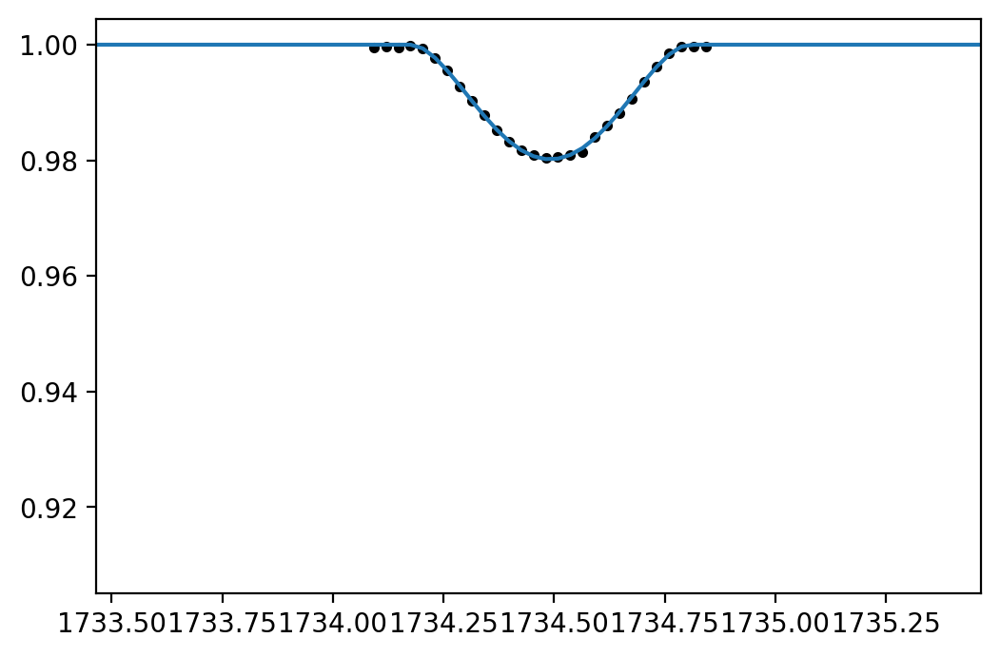

In [15]:
f_c, f_s = 0.6071025773236461, 0.24107770657401392, 

bounds = [
    (50,52),
    (0.01, 0.1),
    (0.1, 0.9),
    (80, 90),
    (0.1, 0.99),
    (t0_guess-1, t0_guess+1),
    (f_c-0.1, f_c+0.1),
    (f_s-0.1, f_s+0.1),
    (0,1),
    (0,1),
    (0,1),
    (0,1),
    (-10,10),
    (-0.1,0.1)
]

u11, u12, u21, u22 = 0., 0.2884, 0., 0.
#     period, rsum, rratio, incl, sbratio, t0, f_c, f_s, q11, q12, q21, q22 = params

params = np.array([
    5.14192040e+01, # Period
    7.17949071e-02, # Rsum
    6.28722905e-01, # Rratio
    8.62150418e+01, # Incl
    6.91829286e-01, # Sbratio
    1.69601971e+03, # t0
    6.20730605e-01, # fc
    1.60481296e-01, # fs
    2.68060970e-01, # q11
    4.55712020e-01, # q12
    8.30538026e-01, # q21
    5.82431661e-02, # q22
    0.,
    0.
])
lc =model(params, full_transit_time)

plt.plot(full_transit_time,full_transit_flux, '.k')
plt.plot(full_transit_time, lc)
plt.xlim(t2_guess-1, t2_guess+1)

In [27]:
from scipy.optimize import differential_evolution

soln = differential_evolution(nll, bounds, args=(full_transit_time, full_transit_flux, full_transit_err))

In [29]:
soln

     fun: -688.3622058183446
 message: 'Optimization terminated successfully.'
    nfev: 148725
     nit: 707
 success: True
       x: array([ 5.14190239e+01,  6.96149983e-02,  4.39300240e-01,  8.64510580e+01,
        9.20819087e-01,  1.69601974e+03,  6.07776370e-01,  2.32895857e-01,
        1.75841144e-01,  6.32755087e-01,  8.46264572e-01,  1.84922569e-01,
       -8.54484421e+00, -3.01058615e-04])

In [23]:
# # #plt.plot(full_transit_time, model(params, full_transit_time))
# soln = minimize(nll, params, args=(full_transit_time, full_transit_flux, full_transit_err), 
#                 method='Nelder-Mead',# tol=100
#                )

In [24]:
soln.x

array([ 5.14056709e+01,  2.05001007e-01,  8.14462135e-01,  8.77887732e+01,
        7.99180105e-01,  1.69602665e+03,  6.07070527e-01,  2.30377170e-01,
        1.86920398e-01,  1.69079440e-03,  1.55374032e-03,  1.32955648e-01,
       -6.45584664e-04, -7.85234192e-03])

(1695.007457617823, 1697.007457617823)

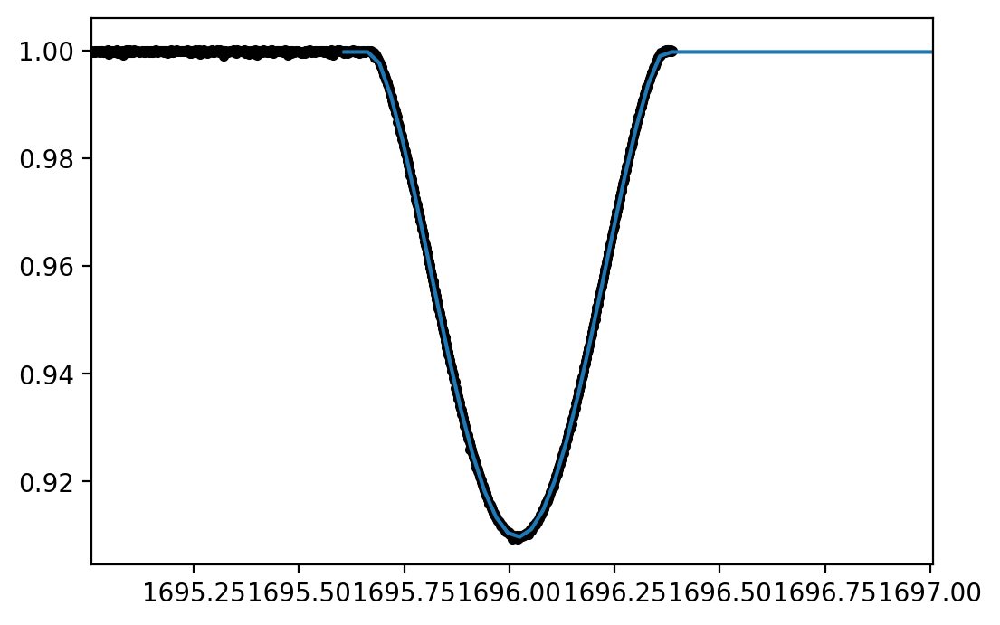

In [30]:
flux = model(soln['x'], full_transit_time)
plt.plot(t,y, '.k')
plt.plot(full_transit_time, flux)
plt.xlim(t0_guess-1, t0_guess+1)

(1733.4655006398082, 1735.4655006398082)

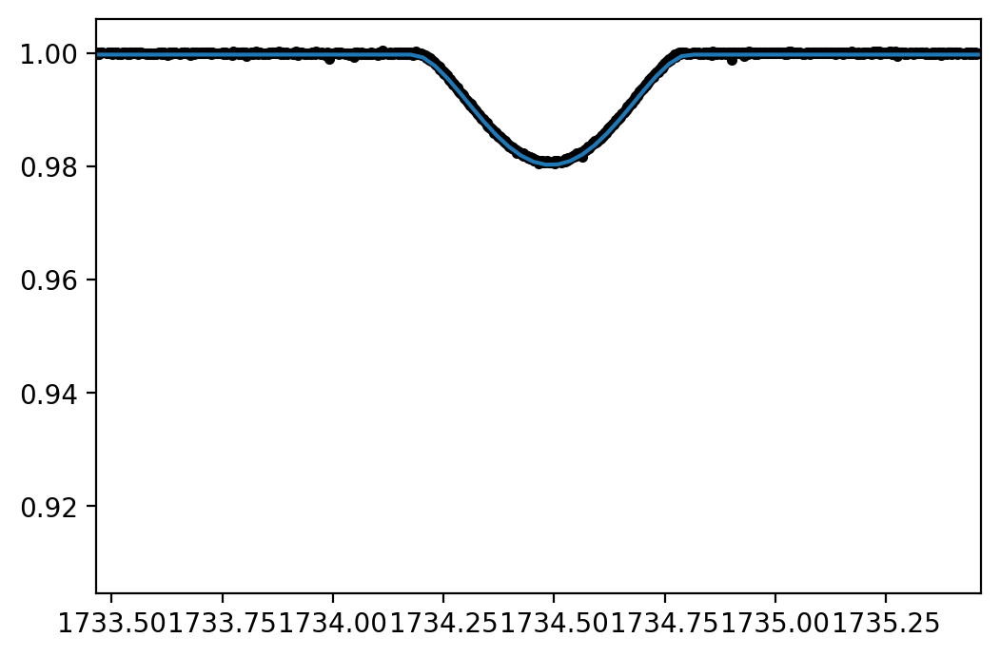

In [32]:
flux = model(soln['x'], full_transit_time)
plt.plot(t,y, '.k')
plt.plot(full_transit_time, flux)
plt.xlim(t2_guess-1, t2_guess+1)

In [33]:
import emcee

pos = soln.x + 1e-4*np.random.randn(32, len(soln.x))
nwalkers, ndim = pos.shape

sampler = emcee.EnsembleSampler(nwalkers, ndim, lnlike, args=(full_transit_time, full_transit_flux, full_transit_err))
sampler.run_mcmc(pos, 10000, progress=True);

/Users/danielhey/anaconda3/envs/phoebe/lib/python3.7/site-packages/emcee/ensemble.py:258: RuntimeWarning: Initial state is not linearly independent and it will not allow a full exploration of parameter space
  category=RuntimeWarning,
100%|██████████| 10000/10000 [13:32<00:00, 12.30it/s] 


In [34]:
discard = 5000
flat_samples = sampler.get_chain(discard=discard,)
#                                  flat=True)

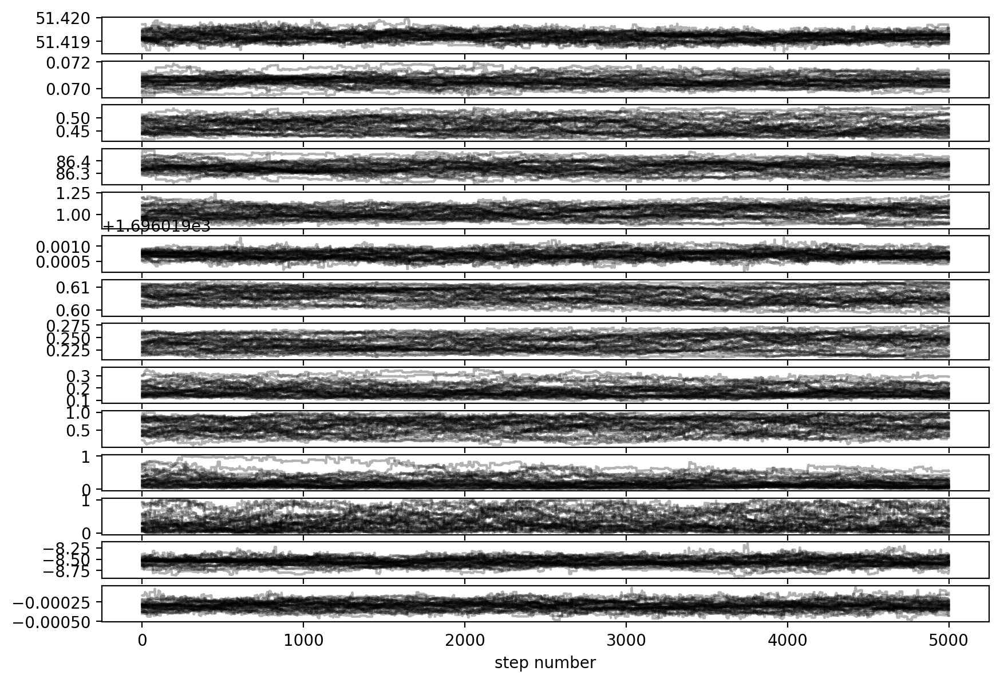

In [35]:
fig, axes = plt.subplots(len(flat_samples.T), figsize=(10, 7), sharex=True)
# samples = sampler.get_chain()
for i in range(ndim):
    ax = axes[i]
    ax.plot(flat_samples[:, :, i], "k", alpha=0.3)
#     ax.set_xlim(0, len(samples))
    ax.yaxis.set_label_coords(-0.1, 0.5)

axes[-1].set_xlabel("step number");

In [36]:
flat_samples = sampler.get_chain(discard=discard,flat=True)

# rsum, rratio, incl, sbratio, t0, f_c, f_s = params

In [21]:
eccen, omega = flat_samples[:,7]**2 + flat_samples[:,6]**2, np.arctan(flat_samples[:,7] / flat_samples[:,6])

In [22]:
full_trace = np.hstack([flat_samples[:,0:6],eccen[:,None], omega[:,None], flat_samples[:,8:]])

In [31]:
np.median(flat_samples[:,0])

51.41920642055753

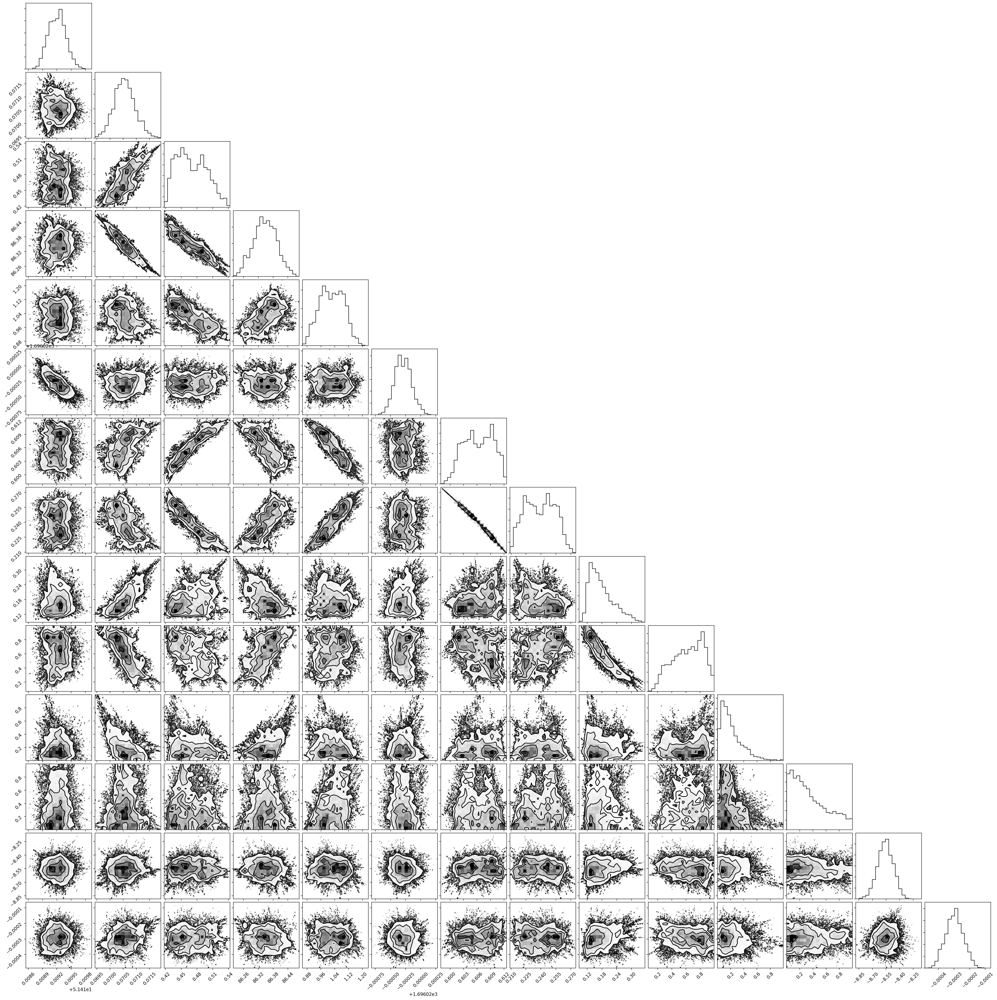

In [37]:
import corner
# flat_samples = sampler.get_chain(flat=True)
#incl, r1, r2, sbratio, q
corner.corner(flat_samples, 
#               labels=['Period', '(R1+R2)/a', 'R2/R1', 'incl', 'sbratio', 't0', 'eccen', 'omega', 'ld11', 'ld12', 'ld21', 'ld22'], show_titles=True, smooth=0.3
             );
# plt.savefig('ellc_fit.png', dpi=300)

In [43]:
rsum, rratio = np.median(flat_samples[:,1]), np.median(flat_samples[:,2])

rsum/(1.+rratio), rsum*rratio/(1.+rratio)

(0.0480998958068993, 0.022443300015445034)

In [ ]:

101

In [57]:
import numpy as np
0.048 * 101 / np.sin(np.radians(86))

4.859838321897523

In [47]:
np.sin(np.degrees(89))

-0.49644606901818217

In [41]:
rsum*rratio/(1.+rratio) * 43 / np.sin(np.degrees(86))

0.9761753905464161

In [1]:
0.63 * 10100

6363.0

In [66]:
params = ['Period', '(R1+R2)/a', 'R2/R1', 'incl', 'sbratio', 't0', 'eccen', 'omega']
# fits = np.percentile(full_trace, axis=0, q=[15.83, 50, 84.16])
for param, i in zip(params, full_trace.T):
#     vals = (np.percentile(i, axis=0, q=[15.83, 50, 84.16]))
#     print('{}, {:.4f}+{:.4f}-{:.4f}'.format(param, vals[1], vals[1] - vals[0], vals[2] - vals[1]))
    mean = np.mean(i, axis=0)
    sd = np.std(i, axis=0)
    print(f'{param}, {mean:.5f}, {sd:.5f}')

Period, 51.41923, 0.00005
(R1+R2)/a, 0.07213, 0.00031
R2/R1, 0.62877, 0.03670
incl, 86.17310, 0.03453
sbratio, 0.76078, 0.03075
t0, 1696.01967, 0.00004
eccen, 0.41346, 0.00132
omega, 0.27860, 0.01339


In [15]:
rsum = 0.07213
rratio = 0.62877

rsum*rratio/(1.+rratio) * 43 / np.sin(np.degrees(86))

1.2111254293288067

In [121]:
full_transit_time, full_transit_flux, full_transit_err = np.hstack([t_transit, t_transit2, t_transit3]), np.hstack([y_transit, y_transit2, y_transit3]), np.hstack([yerr_transit, yerr_transit2, yerr_transit3])

(1746.4350676780027, 1748.4350676780027)

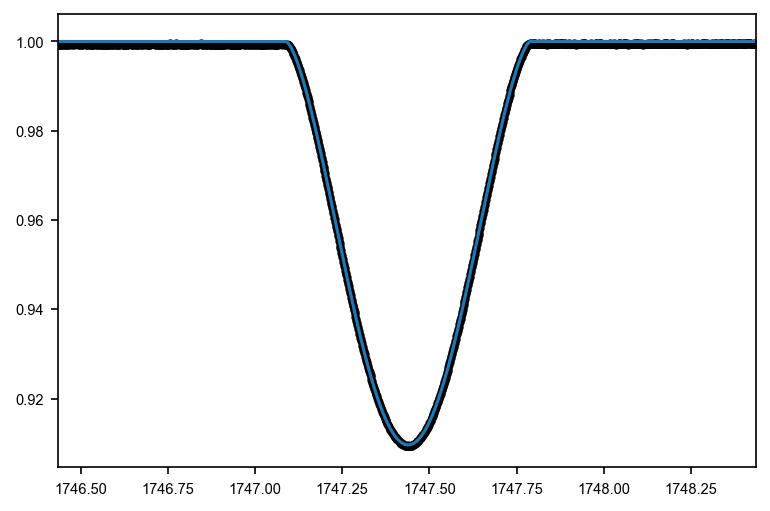

In [81]:


lc =model(np.median(flat_samples, axis=0), t)

plt.plot(t,y, '.k')
plt.plot(t, lc)
plt.xlim(t1_guess-1, t1_guess+1)

# Dynesty

In [75]:
0.

0.0717949071

In [40]:

def model(params, x):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, log_f = params
    
    r1, r2 = rsum/(1.+rratio), rsum*rratio/(1.+rratio)
    lc = ellc.lc(x,t_zero=t0, #q=q,
            radius_1=r1, radius_2=r2,
             incl=incl, #hf_1=h1, hf_2=h2,
             sbratio=sbratio, shape_1='sphere', shape_2='sphere',# ld_1='quad', ld_2='quad', ldc_1=[u11, u12], 
                 ldc_2=[u21, u22],
             period=period, f_c=f_c, f_s=f_s)
    return lc# + mean# / np.max(lc)

def lnlike2(params, x, y, yerr):
    period, rsum, rratio, incl, sbratio, t0, f_c, f_s, log_f = params
    model_flux = model(params, x)
    sigma2 = yerr ** 2 + model_flux ** 2 * np.exp(2 * log_f)
    return -0.5*np.sum((y-model_flux)**2/sigma2 + np.log(sigma2))
    
from scipy.optimize import minimize
nll = lambda *args: -lnlike(*args)

In [41]:
bounds = [
    (50,52),
    (0.01, 0.1),
    (0.1, 0.9),
    (80, 90),
    (0.1, 0.99),
    (t0_guess-1, t0_guess+1),
    (f_c-0.1, f_c+0.1),
    (f_s-0.1, f_s+0.1),
    (-10,10)
]

In [42]:
def prior_transform(u):
    """Transforms the uniform random variable `u ~ Unif[0., 1.)`
    to the parameter of interest `x ~ Unif[-10., 10.)`."""
    x = np.array(u)
    for i,bound in enumerate(bounds):
        x[i] = (bound[1] - bound[0])*u[i] + bound[0]
#     print(x)
    return x

In [43]:
from dynesty import NestedSampler

# initialize our nested sampler
sampler = NestedSampler(lnlike2, prior_transform, 9, nlive=1000, #bound='multi',
                        logl_args=[full_transit_time, full_transit_flux, full_transit_err]
                       )

In [44]:
sampler.run_nested(maxiter=20000)

20001it [08:35, 38.77it/s, +1000 | bound: 75 | nc: 1 | ncall: 149015 | eff(%): 14.093 | loglstar:   -inf < 451.346 <    inf | logz: 424.336 +/-    nan | dlogz:  0.749 >  1.009]


In [47]:
sampler.run_nested(maxiter=20000)

20232it [01:46,  1.82it/s, bound: 91 | nc: 147 | ncall: 176828 | eff(%): 11.442 | loglstar:   -inf < 388.033 <    inf | logz: 366.689 +/-  0.200 | dlogz: 64.439 >  1.009]   Traceback (most recent call last):
  File "/Users/danielhey/anaconda3/envs/phoebe/lib/python3.7/site-packages/dynesty/dynesty.py", line 860, in __call__
    return self.func(x, *self.args, **self.kwargs)
  File "<ipython-input-40-3a4df1b43d29>", line 15, in lnlike2
    model_flux = model(params, x)
  File "<ipython-input-40-3a4df1b43d29>", line 10, in model
    period=period, f_c=f_c, f_s=f_s)
  File "/Users/danielhey/anaconda3/envs/phoebe/lib/python3.7/site-packages/ellc/lc.py", line 606, in lc
    n_mugrid_1, mugrid_1,n_mugrid_2, mugrid_2, verbose)
KeyboardInterrupt
20232it [01:47, 188.61it/s, bound: 91 | nc: 147 | ncall: 176828 | eff(%): 11.442 | loglstar:   -inf < 388.033 <    inf | logz: 366.689 +/-  0.200 | dlogz: 64.439 >  1.009]

Exception while calling loglikelihood function:
  params: [ 5.14152819e+01  6.55222698e-02  3.05195190e-01  8.63617050e+01
  2.90061822e-01  1.69603521e+03  6.09939320e-01  2.65783570e-01
 -4.75329453e+00]
  args: [array([1695.60746536, 1695.6352426 , 1695.66301984, 1695.69079708,
       1695.71857432, 1695.74635157, 1695.77412881, 1695.80190605,
       1695.82968329, 1695.85746053, 1695.88523777, 1695.91301501,
       1695.94079224, 1695.96856948, 1695.99634672, 1696.02412396,
       1696.0519012 , 1696.07967844, 1696.10745567, 1696.13523291,
       1696.16301014, 1696.19078738, 1696.21856461, 1696.24634184,
       1696.27411908, 1696.30189631, 1696.32967353, 1696.35745076,
       1696.38522799, 1734.09188741, 1734.11966534, 1734.14744327,
       1734.1752212 , 1734.20299914, 1734.23077707, 1734.25855501,
       1734.28633294, 1734.31411088, 1734.34188881, 1734.36966675,
       1734.39744469, 1734.42522263, 1734.45300057, 1734.48077851,
       1734.50855645, 1734.53633439, 1734.564112

KeyboardInterrupt: 

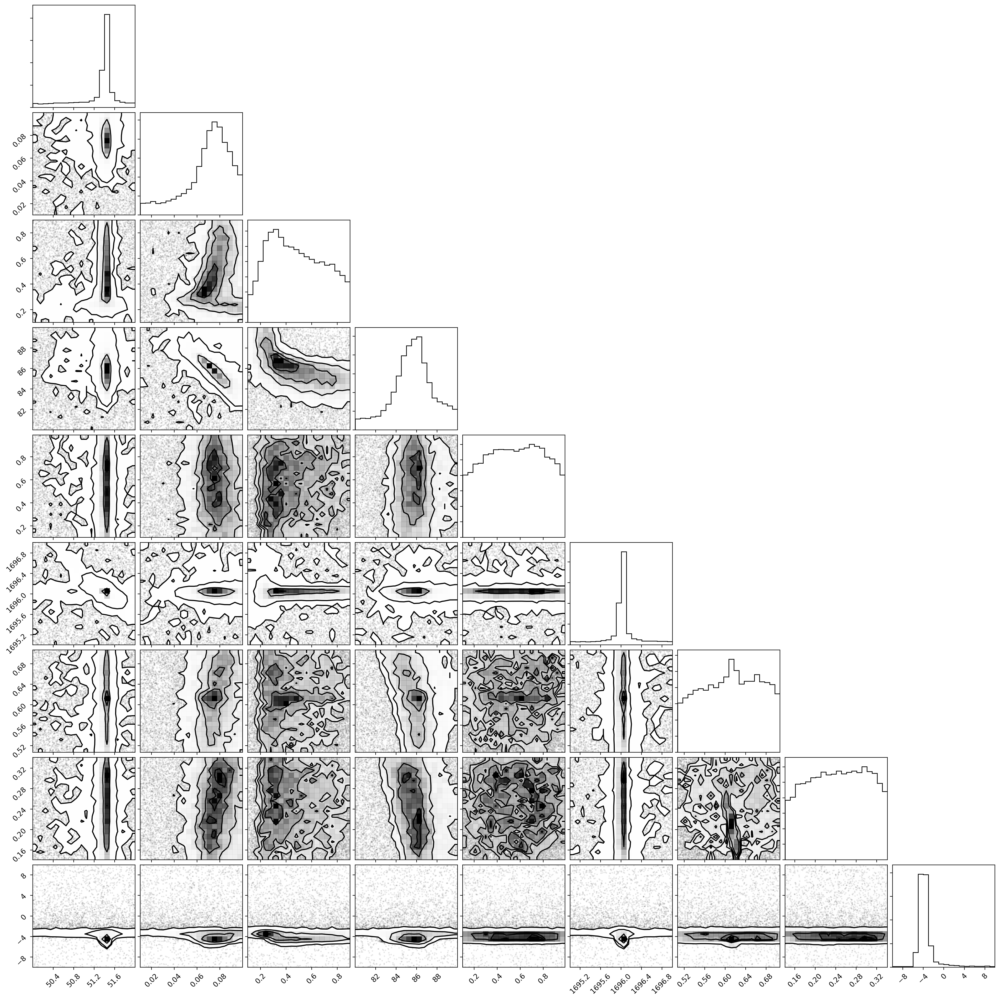

In [45]:
import corner

corner.corner(sampler.results['samples']);

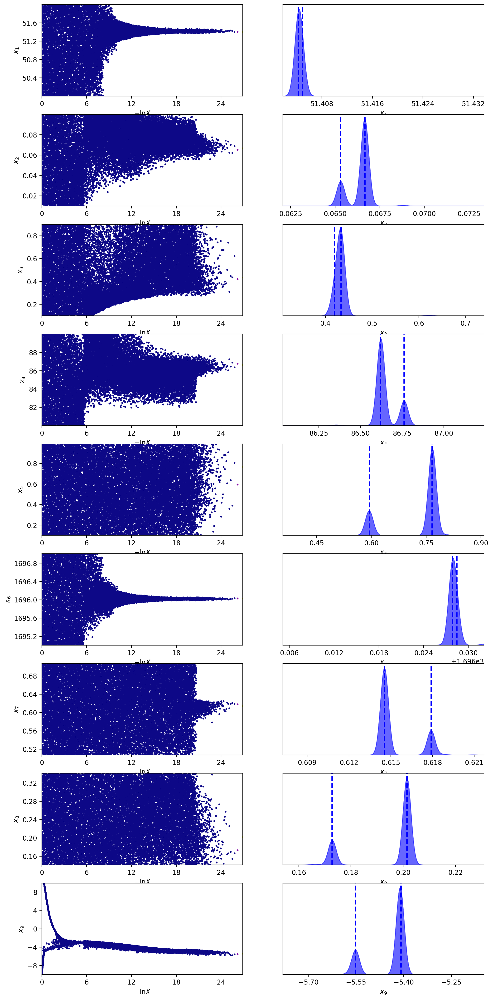

In [46]:
from dynesty import plotting as dyplot

fig, axes = dyplot.traceplot(sampler.results)

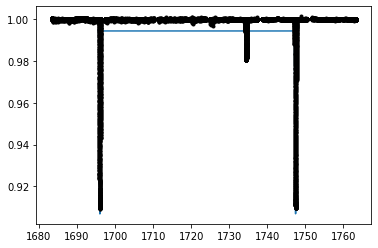

In [256]:
test = model(np.median(sampler.results['samples'][15000:], axis=0), full_transit_time)
plt.plot(full_transit_time, test)

plt.plot(t,y, '.k')